Install requirements using "pip install -r Requirements.txt"

### Data Dictionary
| Variable | Description |
| --- | --- |
|loan_id | Unique loan ID|
|no_of_dependents | Number of dependents of the applicant|
|education | Education level of the applicant|
|self_employed | If the applicant is self-employed or not|
|income_annum | Annual income of the applicant|
|loan_amount | Loan amount requested by the applicant|
|loan_tenure | Tenure of the loan requested by the applicant (in Years)|
|credit_score | credit score of the applicant|
|residential_asset_value | Value of the residential asset of the applicant|
|commercial_asset_value | Value of the commercial asset of the applicant|
|luxury_asset_value | Value of the luxury asset of the applicant|
|bank_assets_value | Value of the bank asset of the applicant|
|loan_status | Status of the loan (Approved/Rejected)|

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
import re
import pyarrow
import warnings

warnings.filterwarnings('ignore', category=UserWarning)
warnings.filterwarnings('ignore', category=FutureWarning)


In [2]:
loan_data = pd.read_csv("data/loan_approval_dataset.csv")
loan_data.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,9600000,29900000,12,778,2400000,17600000,22700000,8000000,Approved
1,2,0,Not Graduate,Yes,4100000,12200000,8,417,2700000,2200000,8800000,3300000,Rejected
2,3,3,Graduate,No,9100000,29700000,20,506,7100000,4500000,33300000,12800000,Rejected
3,4,3,Graduate,No,8200000,30700000,8,467,18200000,3300000,23300000,7900000,Rejected
4,5,5,Not Graduate,Yes,9800000,24200000,20,382,12400000,8200000,29400000,5000000,Rejected


In [3]:
loan_data.to_parquet('data/loan_approval_dataset.pq')

loan_data.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,9600000,29900000,12,778,2400000,17600000,22700000,8000000,Approved
1,2,0,Not Graduate,Yes,4100000,12200000,8,417,2700000,2200000,8800000,3300000,Rejected
2,3,3,Graduate,No,9100000,29700000,20,506,7100000,4500000,33300000,12800000,Rejected
3,4,3,Graduate,No,8200000,30700000,8,467,18200000,3300000,23300000,7900000,Rejected
4,5,5,Not Graduate,Yes,9800000,24200000,20,382,12400000,8200000,29400000,5000000,Rejected


**Data Cleaning**

In [4]:
loan_data.columns

Index(['loan_id', ' no_of_dependents', ' education', ' self_employed',
       ' income_annum', ' loan_amount', ' loan_term', ' cibil_score',
       ' residential_assets_value', ' commercial_assets_value',
       ' luxury_assets_value', ' bank_asset_value', ' loan_status'],
      dtype='object')

In [5]:
data = loan_data

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   loan_id                    4269 non-null   int64 
 1    no_of_dependents          4269 non-null   int64 
 2    education                 4269 non-null   object
 3    self_employed             4269 non-null   object
 4    income_annum              4269 non-null   int64 
 5    loan_amount               4269 non-null   int64 
 6    loan_term                 4269 non-null   int64 
 7    cibil_score               4269 non-null   int64 
 8    residential_assets_value  4269 non-null   int64 
 9    commercial_assets_value   4269 non-null   int64 
 10   luxury_assets_value       4269 non-null   int64 
 11   bank_asset_value          4269 non-null   int64 
 12   loan_status               4269 non-null   object
dtypes: int64(10), object(3)
memory usage: 433.7+ KB


In [7]:
data.columns = data.columns.str.strip()

In [8]:
data.isnull().sum()

loan_id                     0
no_of_dependents            0
education                   0
self_employed               0
income_annum                0
loan_amount                 0
loan_term                   0
cibil_score                 0
residential_assets_value    0
commercial_assets_value     0
luxury_assets_value         0
bank_asset_value            0
loan_status                 0
dtype: int64

In [9]:
data["Movable_assets"] = data["bank_asset_value"] + data["luxury_assets_value"]
data["Immovable_assets"] = data["residential_assets_value"] + data["commercial_assets_value"]
            

In [10]:
data.drop(columns=["bank_asset_value","luxury_assets_value","residential_assets_value","commercial_assets_value"], inplace=True, axis=1)

In [11]:
data.drop("loan_id",axis=1, inplace=True)

In [12]:
data.rename(columns={"cibil_score":"credit_score"},inplace=True)

In [13]:
data.columns

Index(['no_of_dependents', 'education', 'self_employed', 'income_annum',
       'loan_amount', 'loan_term', 'credit_score', 'loan_status',
       'Movable_assets', 'Immovable_assets'],
      dtype='object')

In [14]:
data.isna().sum()

no_of_dependents    0
education           0
self_employed       0
income_annum        0
loan_amount         0
loan_term           0
credit_score        0
loan_status         0
Movable_assets      0
Immovable_assets    0
dtype: int64

In [15]:
print(data["education"].value_counts())
print(data["self_employed"].value_counts())
print(data["loan_status"].value_counts())

education
 Graduate        2144
 Not Graduate    2125
Name: count, dtype: int64
self_employed
 Yes    2150
 No     2119
Name: count, dtype: int64
loan_status
 Approved    2656
 Rejected    1613
Name: count, dtype: int64


In [16]:
data.to_parquet("data/loan_approval_dataset.pq") #ignore this

In [17]:
data.dtypes

no_of_dependents     int64
education           object
self_employed       object
income_annum         int64
loan_amount          int64
loan_term            int64
credit_score         int64
loan_status         object
Movable_assets       int64
Immovable_assets     int64
dtype: object

In [18]:
data.head(2)

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,credit_score,loan_status,Movable_assets,Immovable_assets
0,2,Graduate,No,9600000,29900000,12,778,Approved,30700000,20000000
1,0,Not Graduate,Yes,4100000,12200000,8,417,Rejected,12100000,4900000


In [19]:
data.isna().sum()


no_of_dependents    0
education           0
self_employed       0
income_annum        0
loan_amount         0
loan_term           0
credit_score        0
loan_status         0
Movable_assets      0
Immovable_assets    0
dtype: int64

In [20]:
# data.fillna(data.mean(), inplace=True) #ignore this

**Exploratory Data Analysis**

Number of Dependents

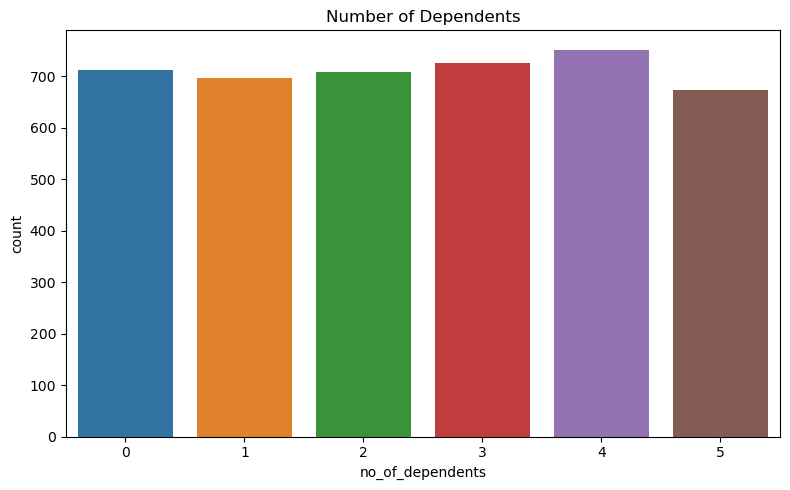

In [21]:
plt.figure(figsize=(8,5))

sns.countplot(x = 'no_of_dependents', data = data,).set_title('Number of Dependents')

plt.tight_layout()
plt.show()

Education and Income

<Axes: xlabel='education', ylabel='income_annum'>

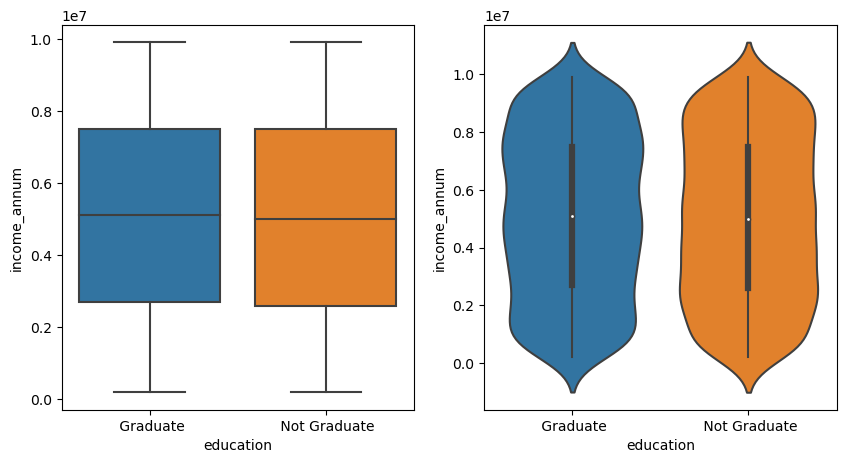

In [22]:
fig, ax = plt.subplots(1,2,figsize=(10, 5))
sns.boxplot(x = 'education', y = 'income_annum', data = data, ax=ax[0])
sns.violinplot(x = 'education', y = 'income_annum', data = data, ax=ax[1])

employment status and education

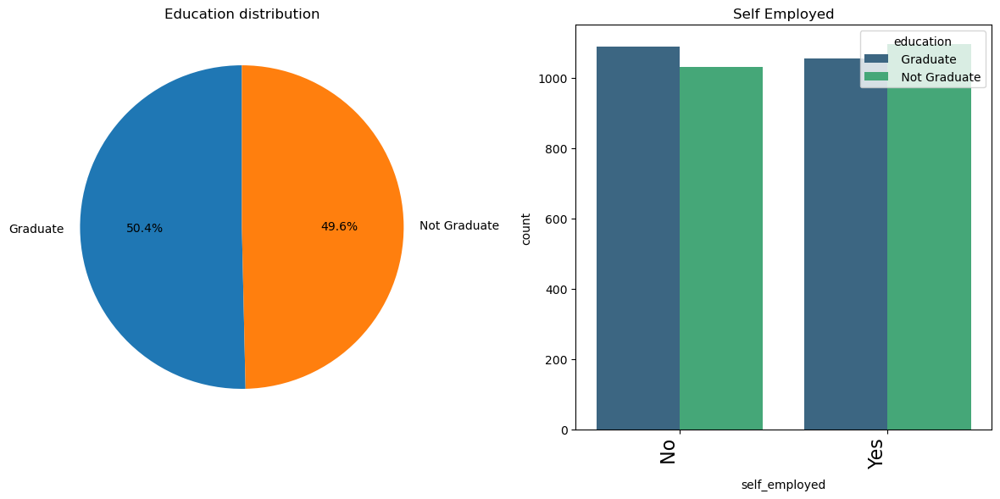

In [23]:
fig , axes = plt.subplots(1,2, figsize=(12,6))

axes[0].pie(data['self_employed'].value_counts(), labels=['Graduate', 'Not Graduate'], autopct='%1.1f%%', startangle=90)
axes[0].set_title('Education distribution')

sns.countplot(x='self_employed', data = data, hue = 'education', palette='viridis', ax=axes[1]).set_title('Self Employed')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, ha='right', fontsize=16)

for ax in axes:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')

plt.tight_layout()
plt.show()

Loan amount and Tenure

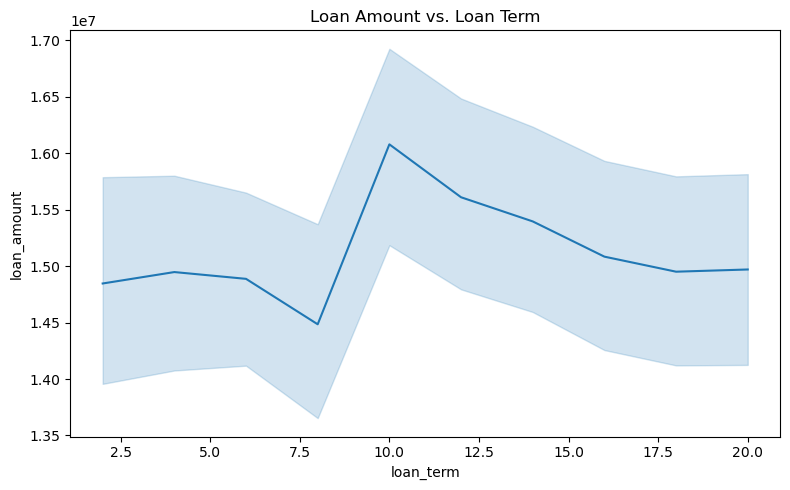

In [24]:
plt.figure(figsize=(8,5))
sns.lineplot(x = 'loan_term', y = 'loan_amount', data = data).set_title('Loan Amount vs. Loan Term')

plt.tight_layout()
plt.show()

Score Distribution


<Axes: xlabel='credit_score', ylabel='Count'>

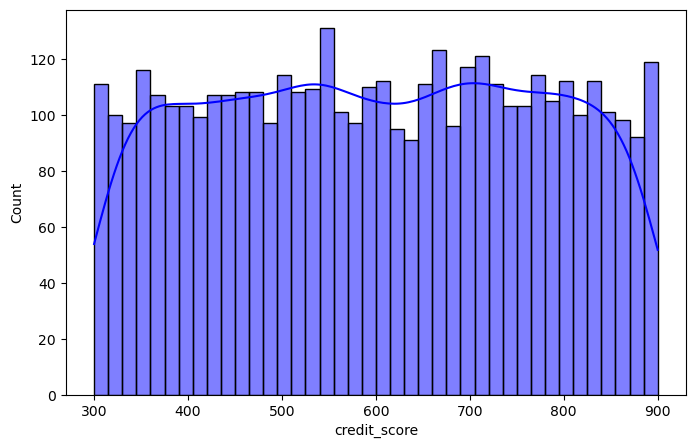

In [25]:
plt.figure(figsize=(8,5))
sns.histplot(data['credit_score'], bins = 40, kde = True, color = 'blue')


|Credit Score|Meaning|
|---|---|
|300-549|Poor|
|550-649|Fair|
|650-749|Good|
|750-799|Very Good|
|800-900|Excellent|

Source: [godigit.com](https://www.godigit.com/finance/credit-score/ranges-of-credit-score)

Asset Distribution

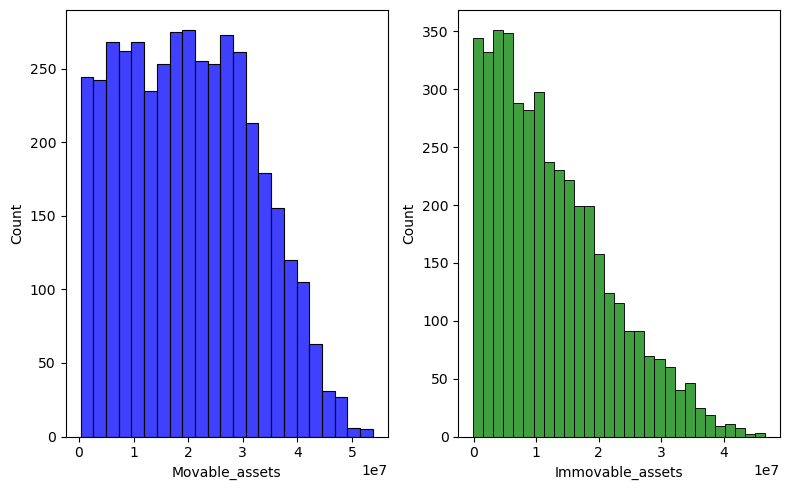

In [26]:
fig, ax = plt.subplots(1,2,figsize=(8,5))
sns.histplot(data['Movable_assets'], ax=ax[0], color='blue')
sns.histplot(data['Immovable_assets'], ax=ax[1], color='green')

plt.tight_layout()
plt.show()

Number of Dependants Vs Loan Status

<Axes: xlabel='no_of_dependents', ylabel='count'>

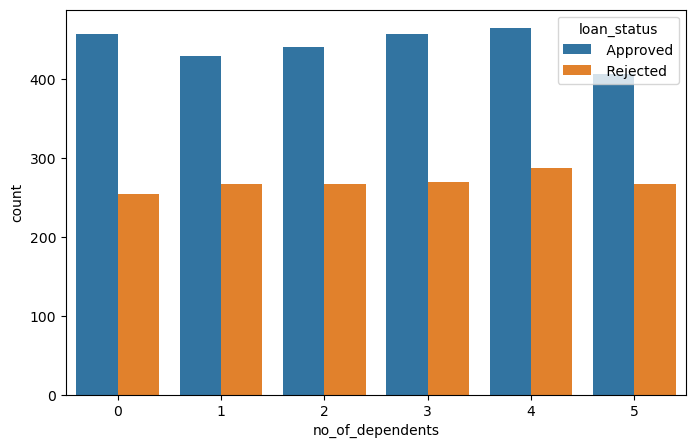

In [27]:
plt.figure(figsize=(8,5))

sns.countplot(x = 'no_of_dependents', data = data, hue = 'loan_status')

Education Vs Loan Status

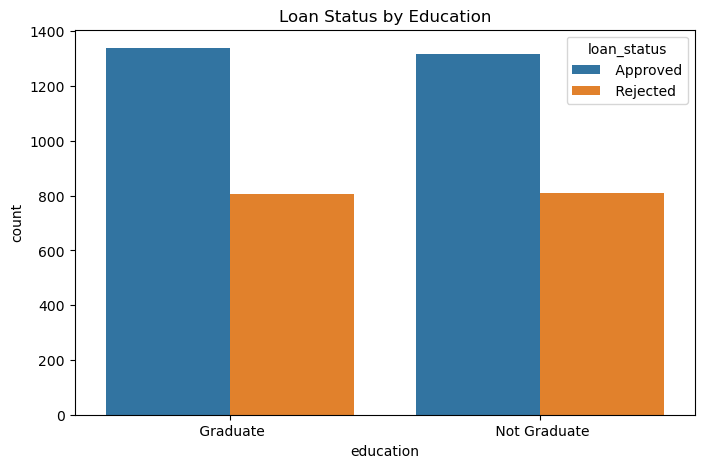

In [28]:
plt.figure(figsize=(8,5))

sns.countplot(x = 'education', hue = 'loan_status', data = data).set_title('Loan Status by Education')

plt.show()

Asset Vs Loan Status

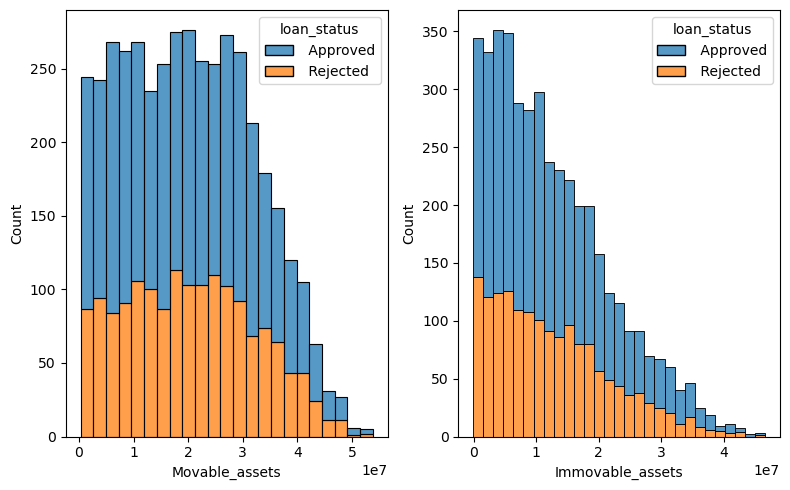

In [29]:
fig, ax = plt.subplots(1,2,figsize=(8,5))
sns.histplot(x  = 'Movable_assets', data = data, ax=ax[0], hue = 'loan_status', multiple='stack')
sns.histplot(x =  'Immovable_assets', data = data, ax=ax[1], hue  = 'loan_status', multiple='stack')

plt.tight_layout()
plt.show()

Loan Amount and Tenure VS Loan Status

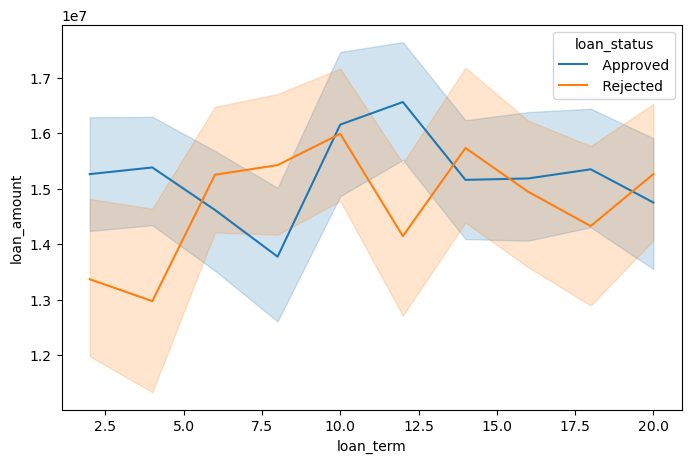

In [30]:
plt.figure(figsize=(8,5))
sns.lineplot(x='loan_term', y='loan_amount', data=data, hue='loan_status')

plt.show()

Credit score vs Loan Status

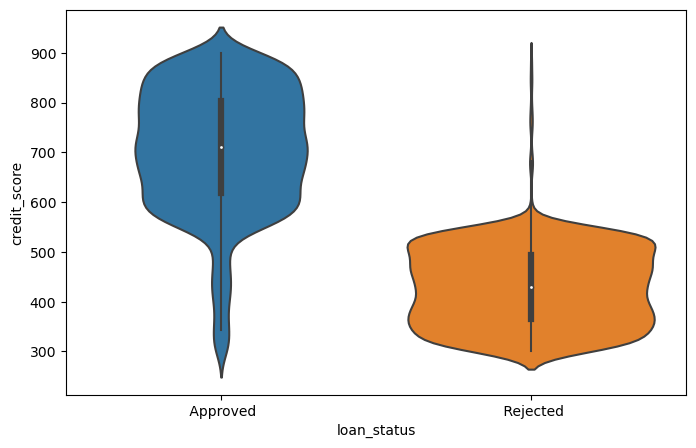

In [31]:
plt.figure(figsize=(8,5))

sns.violinplot(x='loan_status', y='credit_score', data=data)

plt.show()

Assets and Income per annum Vs Loan Amount and a boxplot showing No of dependent vs loan amount

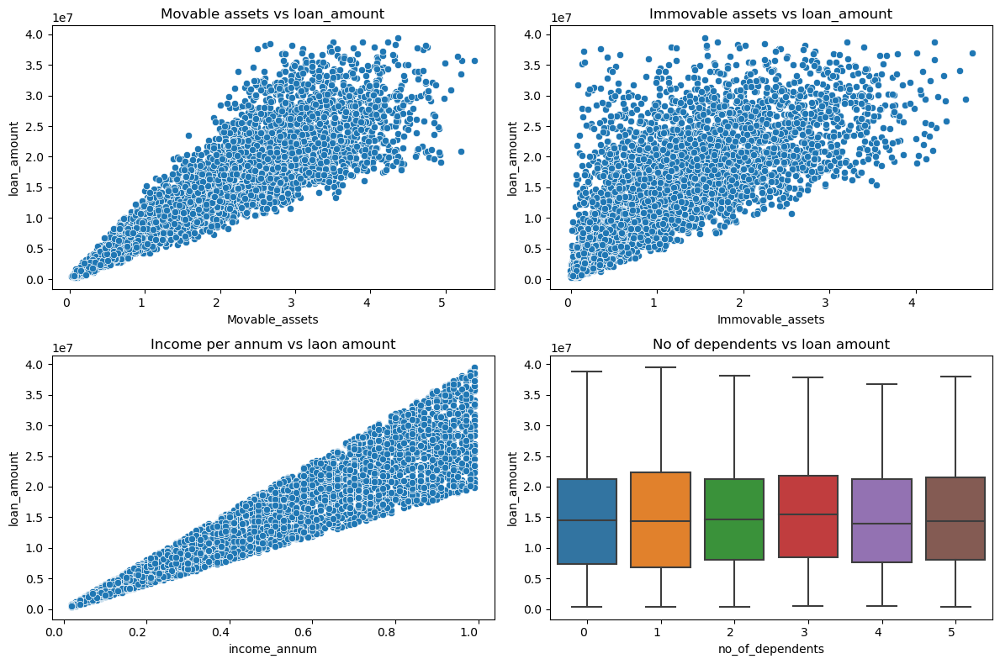

In [32]:
fig, ax = plt.subplots(2,2,figsize=(12, 8))
sns.scatterplot(x='Movable_assets', y = 'loan_amount', data = data, ax=ax[0,0]).set_title('Movable assets vs loan_amount')
sns.scatterplot(x='Immovable_assets', y = 'loan_amount', data = data, ax=ax[0,1]).set_title('Immovable assets vs loan_amount')
sns.scatterplot(x='income_annum', y = 'loan_amount', data = data, ax=ax[1,0]).set_title('Income per annum vs laon amount')
sns.boxplot(x='no_of_dependents', y='loan_amount', data = data, ax=ax[1,1]).set_title('No of dependents vs loan amount')

for axes_row in ax:
    for axes in axes_row:
        axes.set_xticklabels(axes.get_xticklabels(), rotation=0, ha='right')
        axes.set_title(axes.get_title(), fontsize=12)


plt.tight_layout()
plt.show()

In [33]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   no_of_dependents  4269 non-null   int64 
 1   education         4269 non-null   object
 2   self_employed     4269 non-null   object
 3   income_annum      4269 non-null   int64 
 4   loan_amount       4269 non-null   int64 
 5   loan_term         4269 non-null   int64 
 6   credit_score      4269 non-null   int64 
 7   loan_status       4269 non-null   object
 8   Movable_assets    4269 non-null   int64 
 9   Immovable_assets  4269 non-null   int64 
dtypes: int64(7), object(3)
memory usage: 333.6+ KB


**Data Preprocessing**

In [34]:

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

data["education"] = label_encoder.fit_transform(data["education"])
data["self_employed"] = label_encoder.fit_transform(data["self_employed"])
data["loan_status"] = label_encoder.fit_transform(data["loan_status"]) 

data.head(2)
            

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,credit_score,loan_status,Movable_assets,Immovable_assets
0,2,0,0,9600000,29900000,12,778,0,30700000,20000000
1,0,1,1,4100000,12200000,8,417,1,12100000,4900000


correlation heatmap

<Axes: >

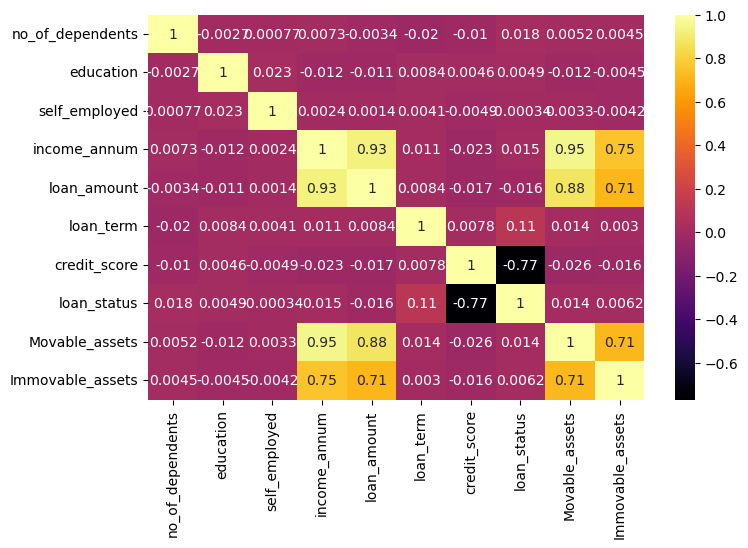

In [35]:
plt.figure(figsize=(8,5))
sns.heatmap(data.corr(), annot=True, cmap='inferno')

Train-test split

In [36]:
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(data.drop('loan_status', axis=1), data['loan_status'], test_size=0.2, random_state=42)

print('training set:', X_train.shape, y_train.shape)
print('Testing set:', X_test.shape, y_test.shape)

training set: (3415, 9) (3415,)
Testing set: (854, 9) (854,)


Model development for loan approval prediction.

- I'll be using the following selected machine learning algorithms to predict the loan approval status.
1. Random forest classifier
2. Xgboost classifier
3. Catboost classifier

combining the GridSearch and BayesSearch for the hyperparameter tuning as to get the best parameter.

In [37]:
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from skopt import BayesSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import f1_score, precision_score, accuracy_score, recall_score
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error


**Random Forest Classifier**

In [38]:
rfc_model = RandomForestClassifier()

rfc_params = {
    'n_estimators':[100,200,300],
    'max_depth':[None,10,20,30],
    'min_samples_split':[2,5,10],
    'min_samples_leaf':[1,2,4],
    'max_features':['auto','sqrt','log2'],
    'bootstrap':[True, False]
}

Bayes_search = BayesSearchCV(rfc_model, rfc_params, cv=5, error_score='raise')
Bayes_search.fit(X_train, y_train)

print('Best params:', Bayes_search.best_params_)
print('Best score (accuracy):', Bayes_search.best_score_)

best_rfc_params = Bayes_search.best_params_

In [ ]:
rfc_model = RandomForestClassifier(**best_rfc_params)
rfc_model.fit(X_train, y_train)

rfc_model

RandomForestClassifier(bootstrap=False, max_depth=30, min_samples_leaf=2,
                       n_estimators=300)

In [ ]:
rfc_pred = rfc_model.predict(X_test)

rfc_pred[0:5]

array([1, 0, 1, 0, 0])

**XGBoost Classifier**

In [ ]:
xgb_model = XGBClassifier()

xgb_params = {
    'n_estimators':[100,200,300],
    'max_depth':[3,5,7],
    'learning_rate':[0.01,0.1,0.2],
    'subsample':[0.8,0.9,1.0],
    'colsample_bytree':[0.8,0.9,1.0],
    'gamma':[0,0.1,0.2],
    'min_child_weight':[1,2,3]
}

Grid_search = GridSearchCV(xgb_model, xgb_params, cv=5, error_score='raise')
Grid_search.fit(X_train, y_train)

print('Best parameter:', Grid_search.best_params_)
print('Best Score(Accuracy):', Grid_search.best_score_)

Best_xgb_params = Grid_search.best_params_

Best parameter: {'colsample_bytree': 0.8, 'gamma': 0, 'learning_rate': 0.2, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 300, 'subsample': 0.8}
Best Score(Accuracy): 0.9871156661786238


In [ ]:
xgb_model = XGBClassifier(**Best_xgb_params)
xgb_model.fit(X_train, y_train)

xgb_model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=300, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [ ]:
xgb_pred = xgb_model.predict(X_test)

xgb_pred[0:5]

array([1, 0, 1, 0, 0])

**CatBoost Classifier**

In [ ]:
cat_model = CatBoostClassifier()

cat_params = {
    'learning_rate':[0.01,0.1,0.2],
    'depth':[1,5,7],
    'l2_leaf_reg':[0,0.1,0.2],
    'subsample':[0.1,0.2,0.3],
    
    }

Grid_search = GridSearchCV(cat_model, cat_params, cv=5, error_score='raise')
Grid_search.fit(X_train, y_train)

print('Best parameter:', Grid_search.best_params_)
print('Best Score(Accuracy):', Grid_search.best_score_)

Best_cat_params = Grid_search.best_params_

0:	learn: 0.6756804	total: 151ms	remaining: 2m 30s
1:	learn: 0.6582325	total: 152ms	remaining: 1m 15s
2:	learn: 0.6461460	total: 153ms	remaining: 51s
3:	learn: 0.6297348	total: 155ms	remaining: 38.6s
4:	learn: 0.6183877	total: 156ms	remaining: 31.1s
5:	learn: 0.6066480	total: 157ms	remaining: 26.1s
6:	learn: 0.5926931	total: 159ms	remaining: 22.5s
7:	learn: 0.5790319	total: 160ms	remaining: 19.8s
8:	learn: 0.5653925	total: 162ms	remaining: 17.8s
9:	learn: 0.5544754	total: 163ms	remaining: 16.1s
10:	learn: 0.5412210	total: 165ms	remaining: 14.8s
11:	learn: 0.5316422	total: 166ms	remaining: 13.7s
12:	learn: 0.5197926	total: 168ms	remaining: 12.7s
13:	learn: 0.5077534	total: 169ms	remaining: 11.9s
14:	learn: 0.4965701	total: 171ms	remaining: 11.2s
15:	learn: 0.4870602	total: 172ms	remaining: 10.6s
16:	learn: 0.4769620	total: 173ms	remaining: 10s
17:	learn: 0.4664491	total: 174ms	remaining: 9.51s
18:	learn: 0.4563180	total: 176ms	remaining: 9.07s
19:	learn: 0.4465577	total: 177ms	remaining

In [ ]:
cat_model = CatBoostClassifier(**Best_cat_params)
cat_model.fit(X_train, y_train)

cat_model

0:	learn: 0.6679817	total: 4.42ms	remaining: 4.42s
1:	learn: 0.6391967	total: 10.6ms	remaining: 5.27s
2:	learn: 0.6131656	total: 16.1ms	remaining: 5.35s
3:	learn: 0.5918748	total: 20.3ms	remaining: 5.04s
4:	learn: 0.5660667	total: 24.3ms	remaining: 4.84s
5:	learn: 0.5469790	total: 30.1ms	remaining: 4.99s
6:	learn: 0.5222675	total: 35.1ms	remaining: 4.98s
7:	learn: 0.4992319	total: 40.4ms	remaining: 5.01s
8:	learn: 0.4781898	total: 45.3ms	remaining: 4.99s
9:	learn: 0.4617343	total: 49.9ms	remaining: 4.93s
10:	learn: 0.4454000	total: 54.4ms	remaining: 4.89s
11:	learn: 0.4258819	total: 58.1ms	remaining: 4.79s
12:	learn: 0.4101872	total: 62.1ms	remaining: 4.71s
13:	learn: 0.3944899	total: 65.8ms	remaining: 4.63s
14:	learn: 0.3787765	total: 71.1ms	remaining: 4.67s
15:	learn: 0.3633064	total: 75.3ms	remaining: 4.63s
16:	learn: 0.3504050	total: 79.7ms	remaining: 4.61s
17:	learn: 0.3363097	total: 83.7ms	remaining: 4.57s
18:	learn: 0.3235306	total: 87.4ms	remaining: 4.51s
19:	learn: 0.3128902	t

In [ ]:
cat_pred = cat_model.predict(X_test)

cat_pred[0:5]

array([1, 0, 1, 0, 0], dtype=int64)

**Model Evaluation**

- Confusion Matrix

In [ ]:
def Plot_confusionmatrix(y_true, y_preds, model_names):
    fig, axes = plt.subplots(1, len(y_preds), figsize=(15,6))
    
    for i, (pred, model_name) in enumerate(zip(y_preds, model_names)):
        
        cm = confusion_matrix(y_true, pred)
        ax = axes[i]
        sns.heatmap(cm, annot=True, ax=ax, cmap='viridis')
        ax.set_xlabel('Predicted')
        ax.set_ylabel('Actual')
        ax.set_title(f"Confusion Matrix - {model_name}")
        ax.xaxis.set_ticklabels(['False Positive', 'True Negative'])
        ax.yaxis.set_ticklabels(['True Positive ', 'False Negative'])
    
    plt.tight_layout()
    plt.show()

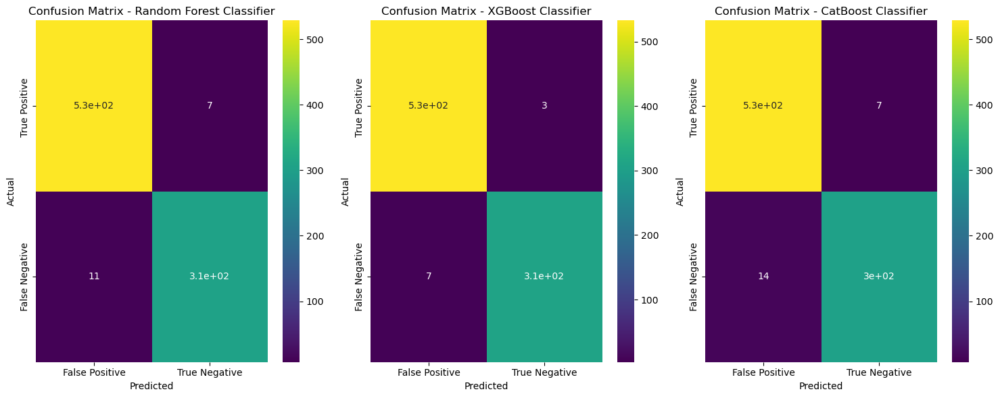

In [ ]:
y_true = y_test
y_preds = [rfc_pred, xgb_pred, cat_pred]
model_names = ['Random Forest Classifier','XGBoost Classifier','CatBoost Classifier']

Plot_confusionmatrix(y_true, y_preds, model_names)

- True Positive (TP): The model correctly predicts positive instances as positive.
- False Positive (FP): The model incorrectly predicts negative instances as positive.
- False Negative (FN): The model incorrectly predicts positive instances as negative.
- True Negative (TN): The model correctly predicts negative instances as negative.

The confusion matrix heatmap visualizes the true positive and true negative value counts in the 3 machine learning models.
`The Random Forest classifier` has only `18` false positive and negative values.\
`The XGBoost classifier` has `10` false positive and negative values.\
`The CatBoost classifier` has `21` false positive and negative values.\

overall, the `XGBoost classifier` has a better accuracy compared to other listed above.

**Performance report**

In [ ]:
r2_score_xgb = r2_score(y_test, xgb_pred)
mse_xgb = mean_squared_error(y_test, xgb_pred)
mae_xgb = mean_absolute_error(y_test, xgb_pred)


r2_score_rf = r2_score(y_test, rfc_pred)
mse_rf = mean_squared_error(y_test, rfc_pred)
mae_rf = mean_absolute_error(y_test, rfc_pred)


r2_score_cat = precision_score(y_test, cat_pred)
mse_cat = mean_squared_error(y_test, cat_pred)
mae_cat = mean_absolute_error(y_test, cat_pred)


In [ ]:

list_r2_score = [r2_score_rf, r2_score_xgb, r2_score_cat]
list_mse = [mse_rf, mse_xgb, mse_cat]
list_mae = [mae_rf, mae_xgb, mae_cat]


Report = pd.DataFrame(list_r2_score, index=['RandomForest Classifier','XGBoost Classifier','CatBoost Classifier'])
Report.columns =['R2 Score']
Report.insert(loc=1,column='Mean Squared Error',value=list_mse)
Report.insert(loc=2, column='Mean Absolute Error', value=list_mae)

Report.columns.name = 'Algorithm'
print(Report)

Algorithm                R2 Score  Mean Squared Error  Mean Absolute Error
RandomForest Classifier  0.909814            0.021077             0.021077
XGBoost Classifier       0.949897            0.011710             0.011710
CatBoost Classifier      0.977492            0.024590             0.024590


**Classification Report**

In [ ]:
print(f"XGBoostClassifier \n\n{classification_report(y_test, xgb_pred)}")
print(f"CatBoostClassifier \n\n{classification_report(y_test, cat_pred)}")
print(f"RandomForestClassifier \n\n{classification_report(y_test, rfc_pred)}")


XGBoostClassifier 

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       536
           1       0.99      0.98      0.98       318

    accuracy                           0.99       854
   macro avg       0.99      0.99      0.99       854
weighted avg       0.99      0.99      0.99       854

CatBoostClassifier 

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       536
           1       0.98      0.96      0.97       318

    accuracy                           0.98       854
   macro avg       0.98      0.97      0.97       854
weighted avg       0.98      0.98      0.98       854

RandomForestClassifier 

              precision    recall  f1-score   support

           0       0.98      0.99      0.98       536
           1       0.98      0.97      0.97       318

    accuracy                           0.98       854
   macro avg       0.98      0.98      0.98       854
weighted

**Conclusion**

Based on the metrics, visualizations, and analysis provided, the `XGBoost Classifier` emerges as the preferred machine learning model for predicting loan approval status. This conclusion is drawn from its higher accuracy of `99%`, compared to `98%` for both the `Random Forest Classifier` and the `CatBoost Classifier`. Consequently, the `XGBoost Classifier` outperformed the other models, demonstrating superior predictive capabilities in this scenario.